# Training

In [1]:
%run train.py --models=knn_rssi

[Indolocate] INFO - Note: NumExpr detected 32 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 16.
[Indolocate] INFO - NumExpr defaulting to 16 threads.



[$] Training KNN_RSSI model...


2025-05-03 20:22:33.453583: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-05-03 20:22:33.460641: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-05-03 20:22:33.462709: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
[Indolocate] INFO - Initializing kNN model
[Indolocate] INFO - Loaded configuration for kNN from package
[Indolocate] INFO - Model trained with 13820 samples.
[Indolocate] INFO - kNN model saved to models/knn_rssi_env1_model.pkl
[Indolocate] INFO - Initializing kNN model
[Indolocate] INFO - Loaded configuration for kNN from package
[Indolocate] INFO - Model train

# Testing

## Datasets

### WILDv2-env1

In [2]:
# Imports
import os
import h5py
import numpy as np

# Supress TF warnings
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

# Mterics initation
metrics = []

# Dataset (WILD v2): https://www.kaggle.com/c/wild-v2
dataset = h5py.File("/mnt/LabData/datasets/indoor_localization/wild-v2/training_data_env1.h5", "r")

# Data initilization
data1 = {
    "csi": np.array(dataset["channels/real"]).T + 1j * np.array(dataset["channels/imag"]).T,        # (samples, carriers, antennas, APs)
    "rssi": np.array(dataset["rssi"]).T,                                                            # (samples, rssi)
    "labels": np.array(dataset["labels"]).T,                                                        # (samples, true_pos)
    "opt": {
        "ant_sep": np.array(dataset["opt/ANT_SEP"]).flatten()[0],                                   # scalar
        "center_freq": np.array(dataset["opt/CENTER_FREQ"]).flatten()[0],                           # scalar
        "bw": np.array(dataset["opt/BW"]).flatten()[0],                                             # scalar
    },
    "ap_locs": np.mean(np.array(dataset["AP_locs"]), axis=1).T,                                     # (samples, coordinates)
}

### WILDv2-env2

In [3]:
# Imports
import os
import h5py
import numpy as np

# Supress TF warnings
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

# Mterics initation
metrics = []

# Dataset (WILD v2): https://www.kaggle.com/c/wild-v2
dataset = h5py.File("/mnt/LabData/datasets/indoor_localization/wild-v2/training_data_env2.h5", "r")

# Data initilization
data2 = {
    "csi": np.array(dataset["channels/real"]).T + 1j * np.array(dataset["channels/imag"]).T,        # (samples, carriers, antennas, APs)
    "rssi": np.array(dataset["rssi"]).T,                                                            # (samples, rssi)
    "labels": np.array(dataset["labels"]).T,                                                        # (samples, true_pos)
    "opt": {
        "ant_sep": np.array(dataset["opt/ANT_SEP"]).flatten()[0],                                   # scalar
        "center_freq": np.array(dataset["opt/CENTER_FREQ"]).flatten()[0],                           # scalar
        "bw": np.array(dataset["opt/BW"]).flatten()[0],                                             # scalar
    },
    "ap_locs": np.mean(np.array(dataset["AP_locs"]), axis=1).T,                                     # (samples, coordinates)
}

## Models

#### K-Nearest Neighbors (kNN)

In [4]:
# RSSI Based

import indolocate
import indolocate.utils as utils
import indolocate.analysis as analysis

X_test1, Y_test1 = utils.get_testset(data1['rssi'], data1['labels'])
X_test2, Y_test2 = utils.get_testset(data2['rssi'], data2['labels'])

model1 = indolocate.init("knn")
model2 = indolocate.init("knn")

model1.load("models/knn_rssi_env1_model.pkl")
model2.load("models/knn_rssi_env2_model.pkl")

Y_pred11 = np.array([model1.predict(x) for x in X_test1])
knn_env11 = analysis.evaluate(Y_test1, Y_pred11, "kNN_Env11")
metrics.append(knn_env11)

Y_pred22 = np.array([model2.predict(x) for x in X_test2])
knn_env22 = analysis.evaluate(Y_test2, Y_pred22, "kNN_Env22")
metrics.append(knn_env22)

Y_pred12 = np.array([model1.predict(x) for x in X_test2])
knn_env12 = analysis.evaluate(Y_test2, Y_pred12, "kNN_Env12")
metrics.append(knn_env12)

Y_pred21 = np.array([model2.predict(x) for x in X_test1])
knn_env21 = analysis.evaluate(Y_test1, Y_pred21, "kNN_Env21")
metrics.append(knn_env21)

[Indolocate] INFO - Initializing kNN model
[Indolocate] INFO - Loaded configuration for kNN from package
[Indolocate] INFO - Initializing kNN model
[Indolocate] INFO - Loaded configuration for kNN from package
[Indolocate] INFO - kNN model loaded from models/knn_rssi_env1_model.pkl
[Indolocate] INFO - kNN model loaded from models/knn_rssi_env2_model.pkl
[Indolocate] INFO - Evaluation done for kNN_Env11
[Indolocate] INFO - Evaluation done for kNN_Env22
[Indolocate] INFO - Evaluation done for kNN_Env12
[Indolocate] INFO - Evaluation done for kNN_Env21


## Analysis

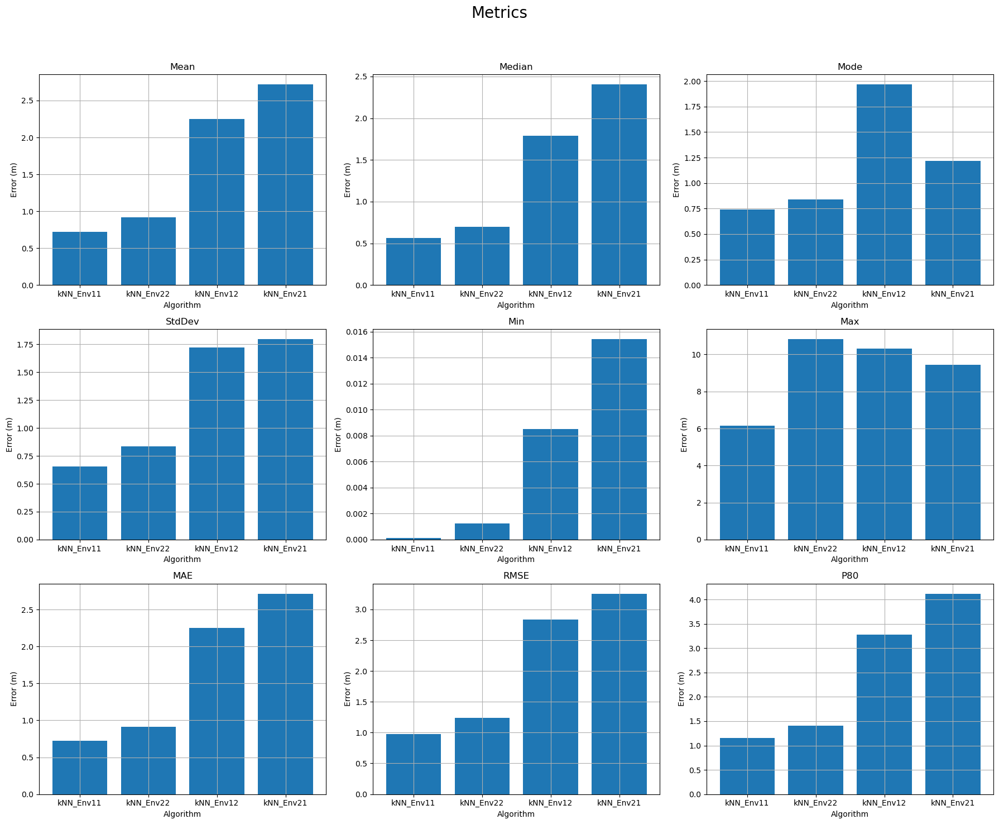

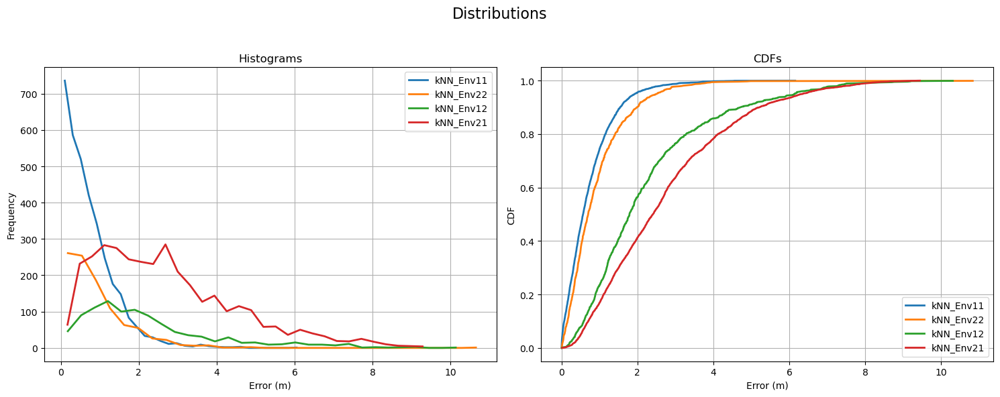

In [5]:
analysis.plot_metrics(metrics)

In [6]:
analysis.display_metrics(metrics)

| Algorithm | Mean   | Median | Mode   | StdDev | Min    | Max     | MAE    | RMSE   | P80    |
|-----------|--------|--------|--------|--------|--------|---------|--------|--------|--------|
| kNN_Env11 | 0.7246 | 0.5651 | 0.7395 | 0.6568 | 0.0001 | 6.1525  | 0.7246 | 0.9780 | 1.1554 |
| kNN_Env22 | 0.9157 | 0.6990 | 0.8418 | 0.8339 | 0.0013 | 10.8296 | 0.9157 | 1.2385 | 1.4094 |
| kNN_Env12 | 2.2491 | 1.7869 | 1.9663 | 1.7225 | 0.0085 | 10.3034 | 2.2491 | 2.8330 | 3.2749 |
| kNN_Env21 | 2.7172 | 2.4032 | 1.2166 | 1.7967 | 0.0154 | 9.4378  | 2.7172 | 3.2575 | 4.1231 |


In [7]:
analysis.display_locations(Y_test1, Y_pred11, "kNN_Env11")
analysis.display_locations(Y_test2, Y_pred22, "kNN_Env22")
analysis.display_locations(Y_test2, Y_pred12, "kNN_Env12")
analysis.display_locations(Y_test1, Y_pred21, "kNN_Env21")


============================== kNN_Env11 ==============================
Index  | True Coordinates          | Predicted Coordinates
----------------------------------------------------------------------
1451   | ( -2.95,  -5.84)          | ( -3.71,  -6.21)
1452   | ( -0.87, -14.38)          | (  0.21, -14.62)
1453   | (  5.93, -10.02)          | (  6.38,  -9.41)
1454   | (  7.26,  -0.87)          | (  7.72,  -0.17)
1455   | (  5.80,  -9.41)          | (  7.08,  -8.60)
51     | ( -4.58,  -2.26)          | ( -4.59,  -2.16)
52     | ( -2.10,   0.58)          | ( -2.58,   1.11)
53     | ( 14.80, -14.49)          | ( 14.77, -14.85)
54     | (  4.77,  -1.84)          | (  3.97,  -2.03)
55     | (  9.82,   0.79)          | (  9.77,   0.85)
567    | (  6.46, -14.82)          | (  6.44, -14.46)
568    | (  6.93,  -1.99)          | (  6.38,  -2.13)
569    | (  6.30,   0.46)          | (  7.48,   0.58)
570    | (  4.70,  -2.12)          | (  4.65,  -2.13)
571    | (  7.99,   0.62)          | (  8

# TestSpace

[Indolocate] INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>
[Indolocate] WARNING - Animation size has reached 21098027 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


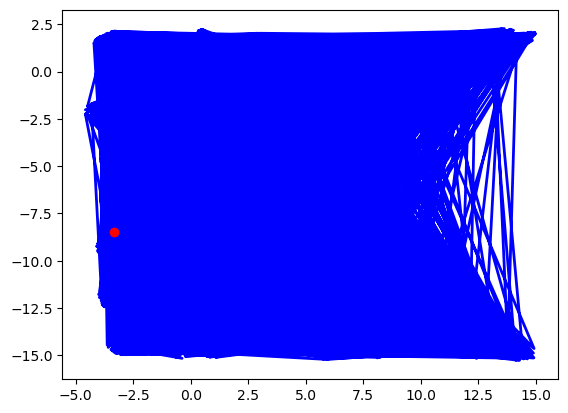

In [8]:
locator = indolocate.locator("127.0.0.1", 9000)

locator.animate(Y_test1)